In [1]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

# import numpy as np # linear algebra
# import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

# import os
# for dirname, _, filenames in os.walk('/kaggle/input'):
#     for filename in filenames:
#         print(os.path.join(dirname, filename))

# You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All" 
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

# Churn Prediction For Bank Customer

We have a dataset in which there are details of a bank's customers and the target variable is a binary variable reflecting the fact whether the customer left the bank (closed his account) or he continues to be a customer.

***The features in the given dataset are:***

- Rownumber: Row Numbers from 1 to 10000
- Customerid: A unique ID that identifies each customer.
- Surname: The customer’s surname.
- Creditscore: A credit score is a number between 300–850 that depicts a consumer's creditworthiness.
- Geography: The country from which the customer belongs to.
- Gender: The customer’s gender: Male, Female
- Age: The customer’s current age, in years, at the time of being customer.
- Tenure: The number of years for which the customer has been with the bank.
- Balance: Bank balance of the customer.
- Numofproducts: the number of bank products the customer is utilising.
- Hascrcard: The number of credit cards given to the customer by the bank.
- Isactivemember: Binary Flag for indicating if the client is active or not with the bank before the moment where the client exits the company (recorded in the variable "exited")
- Exited: Binary flag 1 if the customer closed account with bank and 0 if the customer is retained.

## Improt Libraries

In [2]:
#!pip install pyforest

# 1-Import Libraies
import numpy as np
import pandas as pd 
import seaborn as sns
import matplotlib.pyplot as plt
import scipy.stats as stats
%matplotlib inline
import statsmodels.api as sm
import statsmodels.formula.api as smf
import missingno as msno 

from sklearn.compose import make_column_transformer

#Scaling
from sklearn.preprocessing import scale 
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import PolynomialFeatures 
from sklearn.preprocessing import OneHotEncoder
from sklearn.preprocessing import PowerTransformer 
from sklearn.preprocessing import MinMaxScaler
from sklearn.preprocessing import RobustScaler
from sklearn.model_selection import train_test_split


#Importing plotly and cufflinks in offline mode
import cufflinks as cf
import plotly.io as pio
import plotly.express as px
import plotly.graph_objects as go
import plotly.figure_factory as ff
import plotly.offline
cf.go_offline()
cf.set_config_file(offline=False, world_readable=True)

#Ignore Warnings
import warnings
warnings.filterwarnings("ignore")
warnings.warn("this will not show")

#Figure&Display options
plt.rcParams["figure.figsize"] = (10,6)
pd.set_option('max_colwidth',200)
pd.set_option('display.max_rows', 1000)
pd.set_option('display.max_columns', 200)
pd.set_option('display.float_format', lambda x: '%.3f' % x)

#!pip install termcolor
import colorama
from colorama import Fore, Style  # maakes strings colored
from termcolor import colored

import ipywidgets
from ipywidgets import interact

## User Defined Functions

In [3]:
# To view summary information about the column

def first_looking(col):
    print("column name    : ", col)
    print("--------------------------------")
    print("per_of_nulls   : ", "%", round(df[col].isnull().sum()/df.shape[0]*100, 2))
    print("num_of_nulls   : ", df[col].isnull().sum())
    print("num_of_uniques : ", df[col].nunique())
    print(df[col].value_counts(dropna = False))

In [4]:
# Function for determining the number and percentages of missing values

def missing (df):
    missing_number = df.isnull().sum().sort_values(ascending=False)
    missing_percent = (df.isnull().sum()/df.isnull().count()).sort_values(ascending=False)
    missing_values = pd.concat([missing_number, missing_percent], axis=1, keys=['Missing_Number', 'Missing_Percent'])
    return missing_values

## Ingest Data

In [5]:
df = pd.read_csv("../input/churn-modelling/Churn_Modelling.csv")

In [6]:
# df = pd.read_csv("Churn_Modelling.csv")

In [7]:
df.head()

,RowNumber,CustomerId,Surname,CreditScore,Geography,Gender,Age,Tenure,Balance,NumOfProducts,HasCrCard,IsActiveMember,EstimatedSalary,Exited
0,1,15634602,Hargrave,619,France,Female,42,2,0.000,1,1,1,101348.880,1
1,2,15647311,Hill,608,Spain,Female,41,1,83807.860,1,0,1,112542.580,0
2,3,15619304,Onio,502,France,Female,42,8,159660.800,3,1,0,113931.570,1
3,4,15701354,Boni,699,France,Female,39,1,0.000,2,0,0,93826.630,0
4,5,15737888,Mitchell,850,Spain,Female,43,2,125510.820,1,1,1,79084.100,0


In [8]:
df.tail()

,RowNumber,CustomerId,Surname,CreditScore,Geography,Gender,Age,Tenure,Balance,NumOfProducts,HasCrCard,IsActiveMember,EstimatedSalary,Exited
9995,9996,15606229,Obijiaku,771,France,Male,39,5,0.000,2,1,0,96270.640,0
9996,9997,15569892,Johnstone,516,France,Male,35,10,57369.610,1,1,1,101699.770,0
9997,9998,15584532,Liu,709,France,Female,36,7,0.000,1,0,1,42085.580,1
9998,9999,15682355,Sabbatini,772,Germany,Male,42,3,75075.310,2,1,0,92888.520,1
9999,10000,15628319,Walker,792,France,Female,28,4,130142.790,1,1,0,38190.780,0


In [9]:
df.sample(5)

,RowNumber,CustomerId,Surname,CreditScore,Geography,Gender,Age,Tenure,Balance,NumOfProducts,HasCrCard,IsActiveMember,EstimatedSalary,Exited
7448,7449,15593834,Genovese,691,Spain,Male,36,7,129934.640,1,0,0,75664.560,1
7650,7651,15810716,Kerr,750,Germany,Male,42,8,151836.360,2,1,0,68695.380,0
4379,4380,15808831,Dale,669,France,Male,29,7,0.000,2,1,1,138145.620,0
1513,1514,15729040,Lamb,440,France,Male,42,2,0.000,2,1,0,49826.680,0
4547,4548,15672152,Grant,850,Germany,Male,37,9,122506.380,1,0,1,199693.840,1


## Exploratory Data Analysis and Visualization

1. Implement basic steps to see how is your data looks like
2. Check for missing values
3. Drop the features that not suitable for modelling
4. Implement basic visualization steps such as histogram, countplot, heatmap
5. Convert categorical variables to dummy variables

In [10]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10000 entries, 0 to 9999
Data columns (total 14 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   RowNumber        10000 non-null  int64  
 1   CustomerId       10000 non-null  int64  
 2   Surname          10000 non-null  object 
 3   CreditScore      10000 non-null  int64  
 4   Geography        10000 non-null  object 
 5   Gender           10000 non-null  object 
 6   Age              10000 non-null  int64  
 7   Tenure           10000 non-null  int64  
 8   Balance          10000 non-null  float64
 9   NumOfProducts    10000 non-null  int64  
 10  HasCrCard        10000 non-null  int64  
 11  IsActiveMember   10000 non-null  int64  
 12  EstimatedSalary  10000 non-null  float64
 13  Exited           10000 non-null  int64  
dtypes: float64(2), int64(9), object(3)
memory usage: 1.1+ MB


- The dataset has 14 columns and 10000 observations.

- 11 columns contain numerical data and 3 columns contain categorical values. 

- There seems to be no missing value. 

In [11]:
df.shape

(10000, 14)

In [12]:
print("There is", df.shape[0], "observation and", df.shape[1], "columns in the dataset.")

There is 10000 observation and 14 columns in the dataset.


In [13]:
df.duplicated().sum()

0

In [14]:
print("There is", df.duplicated().sum(), "duplicated observations in the dataset.")

There is 0 duplicated observations in the dataset.


In [15]:
df.isna().sum().any()

False

In [16]:
missing(df)

,Missing_Number,Missing_Percent
RowNumber,0,0.000
CustomerId,0,0.000
Surname,0,0.000
CreditScore,0,0.000
Geography,0,0.000
Gender,0,0.000
Age,0,0.000
Tenure,0,0.000
Balance,0,0.000
NumOfProducts,0,0.000


- There is no missing value in the dataset.

In [17]:
df.nunique()

RowNumber          10000
CustomerId         10000
Surname             2932
CreditScore          460
Geography              3
Gender                 2
Age                   70
Tenure                11
Balance             6382
NumOfProducts          4
HasCrCard              2
IsActiveMember         2
EstimatedSalary     9999
Exited                 2
dtype: int64

In [18]:
# to find how many unique values numerical features have

for col in df.select_dtypes(include=[np.number]).columns:
  print(colored(f"{col}", 'green', attrs=['bold']), f"feature has", colored(f"{df[col].nunique()}", 'green', attrs=['bold']), f"unique values.")

RowNumber feature has 10000 unique values.
CustomerId feature has 10000 unique values.
CreditScore feature has 460 unique values.
Age feature has 70 unique values.
Tenure feature has 11 unique values.
Balance feature has 6382 unique values.
NumOfProducts feature has 4 unique values.
HasCrCard feature has 2 unique values.
IsActiveMember feature has 2 unique values.
EstimatedSalary feature has 9999 unique values.
Exited feature has 2 unique values.


In [19]:
# to find how many unique values object features have

for col in df.select_dtypes(include="object").columns:
  print(colored(f"{col}", 'green', attrs=['bold']), f"feature has", colored(f"{df[col].nunique()}", 'green', attrs=['bold']), f"unique values.")

Surname feature has 2932 unique values.
Geography feature has 3 unique values.
Gender feature has 2 unique values.


- All the values in "RowNumber" and "CustomerId" are unique. The values contained in these columns need to be dropped as they will not help the prediction.
- In addition, the "Surname" column also should be dropped as it does not contain information to help prediction. 

In [20]:
df.describe().T

,count,mean,std,min,25%,50%,75%,max
RowNumber,10000.000,5000.500,2886.896,1.000,2500.750,5000.500,7500.250,10000.000
CustomerId,10000.000,15690940.569,71936.186,15565701.000,15628528.250,15690738.000,15753233.750,15815690.000
CreditScore,10000.000,650.529,96.653,350.000,584.000,652.000,718.000,850.000
Age,10000.000,38.922,10.488,18.000,32.000,37.000,44.000,92.000
Tenure,10000.000,5.013,2.892,0.000,3.000,5.000,7.000,10.000
Balance,10000.000,76485.889,62397.405,0.000,0.000,97198.540,127644.240,250898.090
NumOfProducts,10000.000,1.530,0.582,1.000,1.000,1.000,2.000,4.000
HasCrCard,10000.000,0.706,0.456,0.000,0.000,1.000,1.000,1.000
IsActiveMember,10000.000,0.515,0.500,0.000,0.000,1.000,1.000,1.000
EstimatedSalary,10000.000,100090.240,57510.493,11.580,51002.110,100193.915,149388.247,199992.480


In [21]:
df.describe(include=object).T

,count,unique,top,freq
Surname,10000,2932,Smith,32
Geography,10000,3,France,5014
Gender,10000,2,Male,5457


- As I mentioned above, "RowNumber", "CustomerId" and "Surname" columns will not help the prediction.
- "Tenure", "NumOfProducts", "Geography" columns have multi-class type values.
- "HasCrCard", "IsActiveMember", "Exited", "Gender" columns have binary type values.

***According to the basic examinations on the dataset;***

- We have a classification problem.
- We are going to make classification on the target variable "Exited".
- And we will build a model to get the best classification on the "Exited" column.
- Because of that we are going to look at the balance of "Exited" column.
- "RowNumber", "CustomerId" and "Surname" columns will not help the prediction. So we will drop them.

In [22]:
drop_columns = ["RowNumber", "CustomerId", "Surname"]

df.drop(drop_columns, axis = 1, inplace = True)

In [23]:
df.shape

(10000, 11)

### The Examination of Target Variable

In [24]:
first_looking("Exited")

column name    :  Exited
--------------------------------
per_of_nulls   :  % 0.0
num_of_nulls   :  0
num_of_uniques :  2
0    7963
1    2037
Name: Exited, dtype: int64


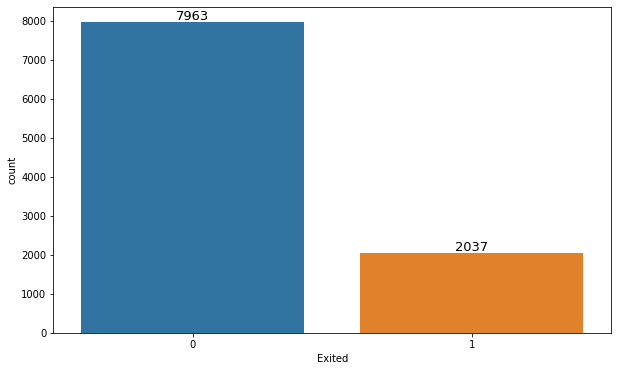

In [25]:
df["Exited"].value_counts()

sns.countplot(x = df["Exited"], data = df)
for index,value in enumerate(df["Exited"].value_counts()):
     plt.text(index, value, f"{value}", ha="center", va="bottom", fontsize = 13)
        


0    7963
1    2037
Name: Exited, dtype: int64


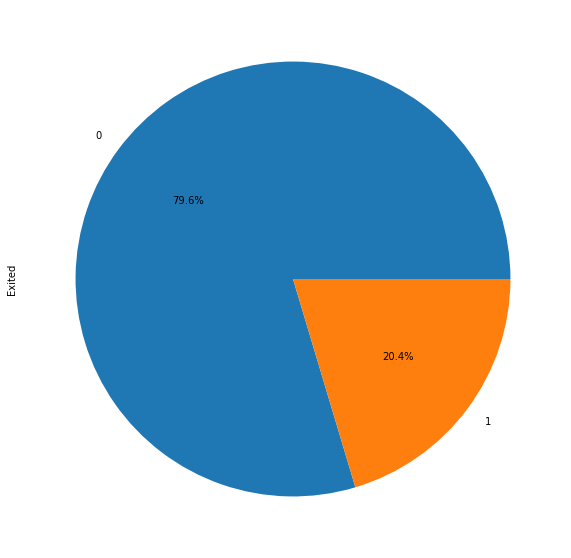

In [26]:
print(df["Exited"].value_counts())
df["Exited"].value_counts().plot(kind="pie", autopct='%1.1f%%', figsize=(10,10));

In [27]:
y = df['Exited']
print(f'Percentage of Exited-1: % {round(y.value_counts(normalize=True)[1]*100,2)} --> \
({y.value_counts()[1]} observations for Exited-1)\nPercentage of Exited-0: % {round(y.value_counts(normalize=True)[0]*100,2)} --> ({y.value_counts()[0]} observations for Exited-0)')

Percentage of Exited-1: % 20.37 --> (2037 observations for Exited-1)
Percentage of Exited-0: % 79.63 --> (7963 observations for Exited-0)


In [28]:
df['Exited'].describe()

count   10000.000
mean        0.204
std         0.403
min         0.000
25%         0.000
50%         0.000
75%         0.000
max         1.000
Name: Exited, dtype: float64

In [29]:
df[df['Exited']==0].describe().T.style.background_gradient(subset=['mean','std','50%','count'], cmap='RdPu')

,count,mean,std,min,25%,50%,75%,max
CreditScore,7963.000000,651.853196,95.653837,405.000000,585.000000,653.000000,718.000000,850.000000
Age,7963.000000,37.408389,10.125363,18.000000,31.000000,36.000000,41.000000,92.000000
Tenure,7963.000000,5.033279,2.880658,0.000000,3.000000,5.000000,7.000000,10.000000
Balance,7963.000000,72745.296779,62848.040701,0.000000,0.000000,92072.680000,126410.280000,221532.800000
NumOfProducts,7963.000000,1.544267,0.509536,1.000000,1.000000,2.000000,2.000000,3.000000
HasCrCard,7963.000000,0.707146,0.455101,0.000000,0.000000,1.000000,1.000000,1.000000
IsActiveMember,7963.000000,0.554565,0.497045,0.000000,0.000000,1.000000,1.000000,1.000000
EstimatedSalary,7963.000000,99738.391772,57405.586966,90.070000,50783.490000,99645.040000,148609.955000,199992.480000
Exited,7963.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000


In [30]:
df[df['Exited']==1].describe().T.style.background_gradient(subset=['mean','std','50%','count'], cmap='RdPu')

,count,mean,std,min,25%,50%,75%,max
CreditScore,2037.000000,645.351497,100.321503,350.000000,578.000000,646.000000,716.000000,850.000000
Age,2037.000000,44.837997,9.761562,18.000000,38.000000,45.000000,51.000000,84.000000
Tenure,2037.000000,4.932744,2.936106,0.000000,2.000000,5.000000,8.000000,10.000000
Balance,2037.000000,91108.539337,58360.794816,0.000000,38340.020000,109349.290000,131433.330000,250898.090000
NumOfProducts,2037.000000,1.475209,0.801521,1.000000,1.000000,1.000000,2.000000,4.000000
HasCrCard,2037.000000,0.699067,0.458776,0.000000,0.000000,1.000000,1.000000,1.000000
IsActiveMember,2037.000000,0.360825,0.480358,0.000000,0.000000,0.000000,1.000000,1.000000
EstimatedSalary,2037.000000,101465.677531,57912.418071,11.580000,51907.720000,102460.840000,152422.910000,199808.100000
Exited,2037.000000,1.000000,0.000000,1.000000,1.000000,1.000000,1.000000,1.000000


- We have an imbalanced data based on the target variable.
- 20.37 % of the customers didn't continue with the bank and left (Exited-1).
- 2037 customer left the bank.
- 79.63 % of the customers continue with the bank and didn't leave (Exited-0).
- 7963 customer didn't leave.

***Let's go on with the examination of numerical and categorical columns.***

In [31]:
numerical= df.drop(['Exited'], axis=1).select_dtypes('number').columns

categorical = df.select_dtypes('object').columns

print(f'Numerical Columns:  {df[numerical].columns}')
print('\n')
print(f'Categorical Columns: {df[categorical].columns}')

Numerical Columns:  Index(['CreditScore', 'Age', 'Tenure', 'Balance', 'NumOfProducts', 'HasCrCard',
       'IsActiveMember', 'EstimatedSalary'],
      dtype='object')


Categorical Columns: Index(['Geography', 'Gender'], dtype='object')


### Numerical Columns

In [32]:
df[numerical].head().T

,0,1,2,3,4
CreditScore,619.000,608.000,502.000,699.000,850.000
Age,42.000,41.000,42.000,39.000,43.000
Tenure,2.000,1.000,8.000,1.000,2.000
Balance,0.000,83807.860,159660.800,0.000,125510.820
NumOfProducts,1.000,1.000,3.000,2.000,1.000
HasCrCard,1.000,0.000,1.000,0.000,1.000
IsActiveMember,1.000,1.000,0.000,0.000,1.000
EstimatedSalary,101348.880,112542.580,113931.570,93826.630,79084.100


In [33]:
df[numerical].describe().T.style.background_gradient(subset=['mean','std','50%','count'], cmap='RdPu')

,count,mean,std,min,25%,50%,75%,max
CreditScore,10000.000000,650.528800,96.653299,350.000000,584.000000,652.000000,718.000000,850.000000
Age,10000.000000,38.921800,10.487806,18.000000,32.000000,37.000000,44.000000,92.000000
Tenure,10000.000000,5.012800,2.892174,0.000000,3.000000,5.000000,7.000000,10.000000
Balance,10000.000000,76485.889288,62397.405202,0.000000,0.000000,97198.540000,127644.240000,250898.090000
NumOfProducts,10000.000000,1.530200,0.581654,1.000000,1.000000,1.000000,2.000000,4.000000
HasCrCard,10000.000000,0.705500,0.455840,0.000000,0.000000,1.000000,1.000000,1.000000
IsActiveMember,10000.000000,0.515100,0.499797,0.000000,0.000000,1.000000,1.000000,1.000000
EstimatedSalary,10000.000000,100090.239881,57510.492818,11.580000,51002.110000,100193.915000,149388.247500,199992.480000


In [34]:
df[numerical].iplot(kind='histogram', subplots=True,bins=50)

In [35]:
for i in numerical:
    df[i].iplot(kind="box", title=i, boxpoints="all", color='lightseagreen')

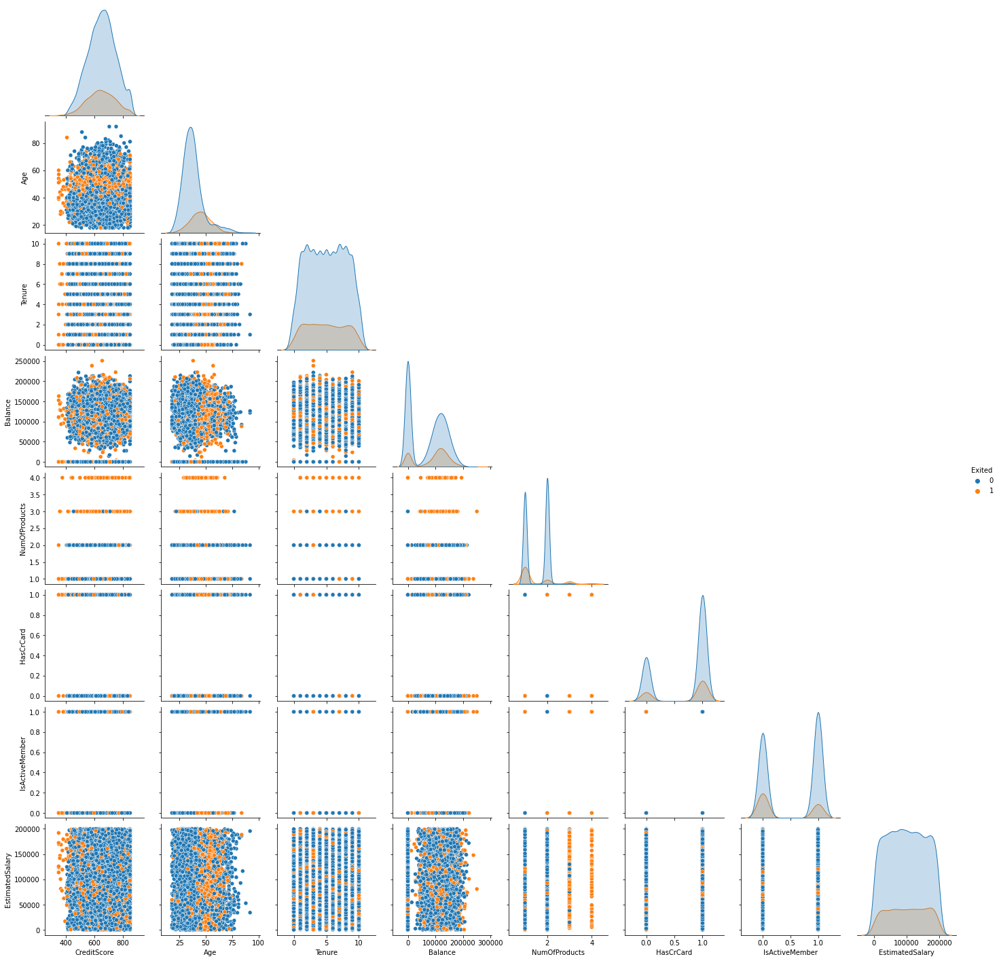

In [36]:
sns.pairplot(df, hue="Exited", corner=True);

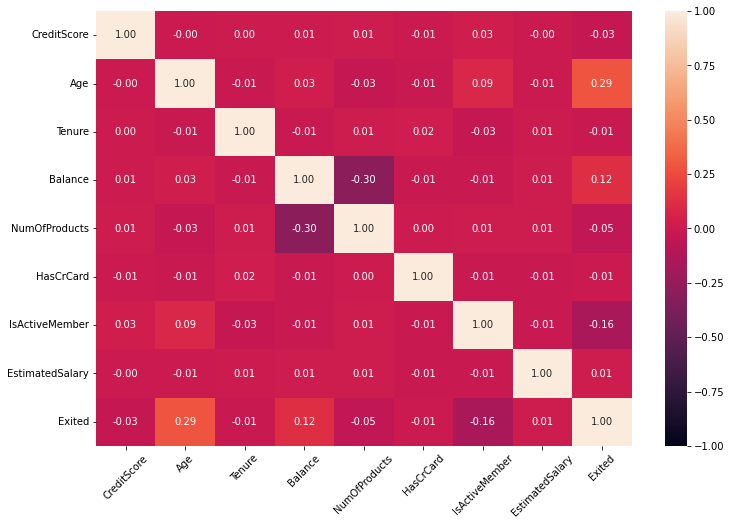

In [37]:
plt.figure(figsize=(12, 8))
sns.heatmap (df.corr(), annot=True, fmt= '.2f', vmin=-1, vmax=1)
plt.xticks(rotation=45);

In [38]:
df.corr()["Exited"].sort_values().drop("Exited").iplot(kind = "barh");

In [39]:
df_temp = df.corr()

count = "Done"
feature =[]
collinear=[]
for col in df_temp.columns:
    for i in df_temp.index:
        if (df_temp[col][i]> .9 and df_temp[col][i] < 1) or (df_temp[col][i]< -.9 and df_temp[col][i] > -1) :
                feature.append(col)
                collinear.append(i)
                print(Fore.RED + f"\033[1mmulticolinearity alert in between\033[0m {col} - {i}")
        else:
            print(f"For {col} and {i}, there is NO multicollinearity problem") 

print("\033[1mThe number of strong corelated features:\033[0m", count) 

For CreditScore and CreditScore, there is NO multicollinearity problem
For CreditScore and Age, there is NO multicollinearity problem
For CreditScore and Tenure, there is NO multicollinearity problem
For CreditScore and Balance, there is NO multicollinearity problem
For CreditScore and NumOfProducts, there is NO multicollinearity problem
For CreditScore and HasCrCard, there is NO multicollinearity problem
For CreditScore and IsActiveMember, there is NO multicollinearity problem
For CreditScore and EstimatedSalary, there is NO multicollinearity problem
For CreditScore and Exited, there is NO multicollinearity problem
For Age and CreditScore, there is NO multicollinearity problem
For Age and Age, there is NO multicollinearity problem
For Age and Tenure, there is NO multicollinearity problem
For Age and Balance, there is NO multicollinearity problem
For Age and NumOfProducts, there is NO multicollinearity problem
For Age and HasCrCard, there is NO multicollinearity problem
For Age and IsA

***CreditScore and Exited***

In [40]:
px.histogram(df, x=df.CreditScore, color="Exited", marginal="box", hover_data=df.columns)

In [41]:
px.scatter(df, x = "CreditScore", y = "Age", color = "Exited")

***Tenure and Exited***

In [42]:
px.histogram(df, x=df.Tenure, color="Exited", marginal="box", hover_data=df.columns)

In [43]:
px.scatter(df, x = "Tenure", y = "Age", color = "Exited")

***Balance and Exited***

In [44]:
px.histogram(df, x=df.Balance, color="Exited", marginal="box", hover_data=df.columns)

In [45]:
px.scatter(df, x = "Balance", y = "Age", color = "Exited")

***NumOfProducts and Exited***

In [46]:
pd.crosstab(df["NumOfProducts"], df["Exited"])

Exited,0,1
NumOfProducts,,
1,3675,1409
2,4242,348
3,46,220
4,0,60


In [47]:
px.histogram(df, x=df.NumOfProducts, color="Exited", marginal="box", hover_data=df.columns)

In [48]:
px.scatter(df, x = "NumOfProducts", y = "Age", color = "Exited")

***HasCrCard and Exited***

In [49]:
pd.crosstab(df["HasCrCard"], df["Exited"])

Exited,0,1
HasCrCard,,
0,2332,613
1,5631,1424


In [50]:
px.histogram(df, x=df.HasCrCard, color="Exited", hover_data=df.columns)

***IsActiveMember and Exited***

In [51]:
pd.crosstab(df["IsActiveMember"], df["Exited"])

Exited,0,1
IsActiveMember,,
0,3547,1302
1,4416,735


In [52]:
px.histogram(df, x=df.IsActiveMember, color="Exited", hover_data=df.columns)

***EstimatedSalary and Exited***

In [53]:
px.histogram(df, x=df.EstimatedSalary, color="Exited", hover_data=df.columns)

In [54]:
px.scatter(df, x = "EstimatedSalary", y = "Age", color = "Exited")

***Based on the examinations made above,***

- There is no multicollinearity problem among the features.
- We have weak level correlation between the numerical features and the target column.
- Also there is weak level correlation between the columns.
- Target variable demonstrates a slight negative correlation with the variables of "creditscore", "tenure", "numberofproducts" 'hascrcard' and 'isactivemember', 
- Target variable demonstrates slight positive correlation with the variables of 'age', 'balance' and 'estimatedsalary".
- Age has more influence on the decision to leave the bank than the other columns.
- It is noteworthy that those who left the bank are in the 45-65 age group. 
- The increase in the number of products negatively affects the decision to continue with the bank.
- Another remarkable situation is the concentration of leaving the bank in the group where the number of products is 3 and 4. 

### Categorical Columns

In [55]:
df[categorical].head().T

,0,1,2,3,4
Geography,France,Spain,France,France,Spain
Gender,Female,Female,Female,Female,Female


In [56]:
df[categorical].describe()

,Geography,Gender
count,10000,10000
unique,3,2
top,France,Male
freq,5014,5457


In [57]:
df[categorical].iplot(kind='histogram', subplots=True,bins=50)

***Geography and Exited***

In [58]:
first_looking("Geography")

column name    :  Geography
--------------------------------
per_of_nulls   :  % 0.0
num_of_nulls   :  0
num_of_uniques :  3
France     5014
Germany    2509
Spain      2477
Name: Geography, dtype: int64


In [59]:
px.histogram(df, x=df.Geography, color="Exited")

In [60]:
pd.crosstab(df["Geography"], df["Exited"])

Exited,0,1
Geography,,
France,4204,810
Germany,1695,814
Spain,2064,413


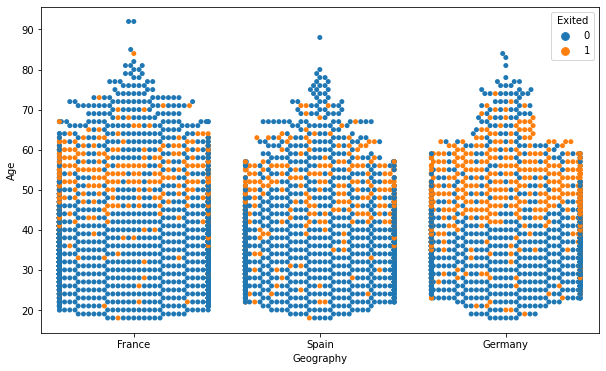

In [61]:
sns.swarmplot(y="Age", x="Geography", hue="Exited", data=df);

***Gender and Exited***

In [62]:
first_looking("Gender")

column name    :  Gender
--------------------------------
per_of_nulls   :  % 0.0
num_of_nulls   :  0
num_of_uniques :  2
Male      5457
Female    4543
Name: Gender, dtype: int64


In [63]:
px.histogram(df, x=df.Gender, color="Exited")

In [64]:
pd.crosstab(df["Gender"], df["Exited"])

Exited,0,1
Gender,,
Female,3404,1139
Male,4559,898


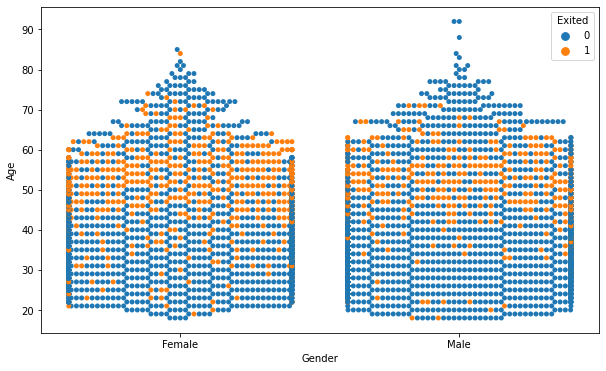

In [65]:
sns.swarmplot(y="Age", x="Gender", hue="Exited", data=df);

- As mentioned above, we can clearly see that leaving the bank is concentrated in the 45-65 age group.

***Before constructing our model, we should convert categorical features into dummies.***

In [66]:
df = pd.get_dummies(df)

In [67]:
df.head(1)

,CreditScore,Age,Tenure,Balance,NumOfProducts,HasCrCard,IsActiveMember,EstimatedSalary,Exited,Geography_France,Geography_Germany,Geography_Spain,Gender_Female,Gender_Male
0,619,42,2,0.000,1,1,1,101348.880,1,1,0,0,1,0


In [68]:
df1 = df.copy()

## Preprocessing of Data

***Train | Test Split, Scalling***

In [69]:
X = df1.drop('Exited', axis = 1)
y = df1['Exited']

In [70]:
X_train, X_test, y_train, y_test = train_test_split(X, y, stratify = y, test_size = 0.1, random_state = 99)

In [71]:
scaler = MinMaxScaler()

In [72]:
X.head()

,CreditScore,Age,Tenure,Balance,NumOfProducts,HasCrCard,IsActiveMember,EstimatedSalary,Geography_France,Geography_Germany,Geography_Spain,Gender_Female,Gender_Male
0,619,42,2,0.000,1,1,1,101348.880,1,0,0,1,0
1,608,41,1,83807.860,1,0,1,112542.580,0,0,1,1,0
2,502,42,8,159660.800,3,1,0,113931.570,1,0,0,1,0
3,699,39,1,0.000,2,0,0,93826.630,1,0,0,1,0
4,850,43,2,125510.820,1,1,1,79084.100,0,0,1,1,0


In [73]:
y

0       1
1       0
2       1
3       0
4       0
       ..
9995    0
9996    0
9997    1
9998    1
9999    0
Name: Exited, Length: 10000, dtype: int64

In [74]:
X_train = scaler.fit_transform(X_train)
X_test = scaler.transform(X_test)

## Modelling & Model Performance

### Import related libraries

In [75]:
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Activation
from tensorflow.keras.callbacks import EarlyStopping
from tensorflow.keras.optimizers import Adam, SGD, Adamax, RMSprop,Adadelta
from tensorflow.keras.layers import Dropout
from sklearn.utils import class_weight
from tensorflow.keras.wrappers.scikit_learn import KerasClassifier
from sklearn.metrics import classification_report, confusion_matrix
from sklearn.metrics import plot_roc_curve, roc_auc_score, roc_curve, average_precision_score
from sklearn.model_selection import cross_val_score, cross_validate
from sklearn.model_selection import GridSearchCV

### Creating Model

### without class_weigth

In [76]:
X_train.shape

(9000, 13)

In [77]:
X_test.shape

(1000, 13)

In [78]:
model = Sequential()

model.add(Dense(32, activation = "relu"))
model.add(Dropout(0.25))
model.add(Dense(16, activation = "relu"))
model.add(Dropout(0.25))
model.add(Dense(1, activation = "sigmoid"))

opt = Adam(lr = 0.001)
model.compile(optimizer = opt, loss = "binary_crossentropy", metrics = ["Recall"])

2021-11-03 12:35:42.129715: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:937] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2021-11-03 12:35:42.130846: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:937] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2021-11-03 12:35:42.131553: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:937] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2021-11-03 12:35:42.132430: I tensorflow/core/platform/cpu_feature_guard.cc:142] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 AVX512F FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compil

In [79]:
early_stop = EarlyStopping(monitor = "val_loss", mode = "auto", verbose = 1, patience = 20)

In [80]:
model.fit(x = X_train, y = y_train, validation_split = 0.1, batch_size = 64, epochs = 500, verbose=1,
          callbacks = [early_stop])

2021-11-03 12:35:54.390169: I tensorflow/compiler/mlir/mlir_graph_optimization_pass.cc:185] None of the MLIR Optimization Passes are enabled (registered 2)


Epoch 1/500
127/127 [==============================] - 2s 5ms/step - loss: 0.5333 - recall: 0.0303 - val_loss: 0.4827 - val_recall: 0.0000e+00
Epoch 2/500
127/127 [==============================] - 1s 5ms/step - loss: 0.4947 - recall: 0.0146 - val_loss: 0.4622 - val_recall: 0.0000e+00
Epoch 3/500
127/127 [==============================] - 1s 5ms/step - loss: 0.4830 - recall: 0.0418 - val_loss: 0.4554 - val_recall: 0.0380
Epoch 4/500
127/127 [==============================] - 1s 4ms/step - loss: 0.4691 - recall: 0.0988 - val_loss: 0.4485 - val_recall: 0.0598
Epoch 5/500
127/127 [==============================] - 0s 4ms/step - loss: 0.4573 - recall: 0.1086 - val_loss: 0.4422 - val_recall: 0.0870
Epoch 6/500
127/127 [==============================] - 1s 4ms/step - loss: 0.4512 - recall: 0.1328 - val_loss: 0.4379 - val_recall: 0.2120
Epoch 7/500
127/127 [==============================] - 0s 4ms/step - loss: 0.4492 - recall: 0.1619 - val_loss: 0.4320 - val_recall: 0.1359
Epoch 8/500
127/127

In [81]:
model.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 32)                448       
_________________________________________________________________
dropout (Dropout)            (None, 32)                0         
_________________________________________________________________
dense_1 (Dense)              (None, 16)                528       
_________________________________________________________________
dropout_1 (Dropout)          (None, 16)                0         
_________________________________________________________________
dense_2 (Dense)              (None, 1)                 17        
Total params: 993
Trainable params: 993
Non-trainable params: 0
_________________________________________________________________


In [82]:
loss_df = pd.DataFrame(model.history.history)
loss_df.head()

,loss,recall,val_loss,val_recall
0,0.533,0.030,0.483,0.000
1,0.495,0.015,0.462,0.000
2,0.483,0.042,0.455,0.038
3,0.469,0.099,0.449,0.060
4,0.457,0.109,0.442,0.087


In [83]:
loss_df = pd.DataFrame(model.history.history)
loss_df.tail()

,loss,recall,val_loss,val_recall
115,0.347,0.435,0.334,0.495
116,0.343,0.457,0.334,0.511
117,0.345,0.448,0.334,0.516
118,0.344,0.457,0.336,0.484
119,0.340,0.449,0.335,0.543


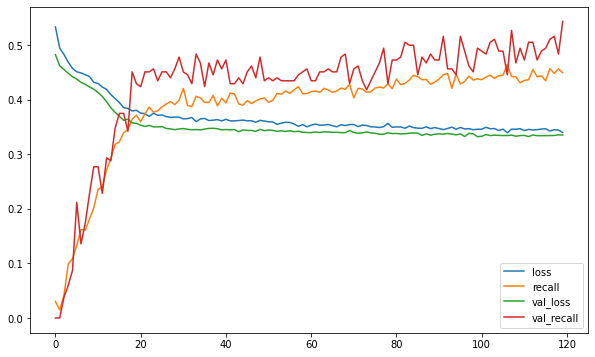

In [84]:
loss_df.plot();

#### Evaluate

In [85]:
model.evaluate(X_test, y_test, verbose=0)

[0.32627955079078674, 0.5343137383460999]

In [86]:
loss, recall = model.evaluate(X_test, y_test, verbose=0)
print("loss : ", loss)
print("recall : ", recall)

loss :  0.32627955079078674
recall :  0.5343137383460999


In [87]:
y_pred = (model.predict(X_test) > 0.5).astype("int32")
print(confusion_matrix(y_test, y_pred))
print(classification_report(y_test, y_pred))

[[759  37]
 [ 95 109]]
              precision    recall  f1-score   support

           0       0.89      0.95      0.92       796
           1       0.75      0.53      0.62       204

    accuracy                           0.87      1000
   macro avg       0.82      0.74      0.77      1000
weighted avg       0.86      0.87      0.86      1000



### ROC (Receiver Operating Curve) and AUC (Area Under Curve) for keras_model

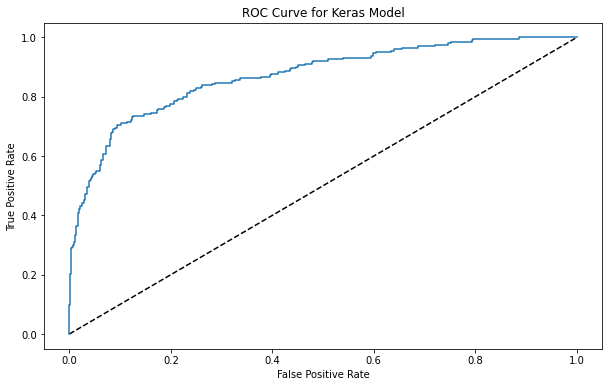

In [88]:
y_pred_proba = model.predict(X_test)
fpr, tpr, thresholds = roc_curve(y_test, y_pred_proba)
plt.plot([0,1],[0,1],'k--')
plt.plot(fpr,tpr, label='ANN')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curve for Keras Model')
plt.show()

In [89]:
roc_auc_score(y_test, y_pred_proba)

0.8706584392550991

In [90]:
average_precision_score(y_test, y_pred_proba)

0.7247782940584069

### with class_weigth

In [91]:
model_weighted = Sequential()

model_weighted.add(Dense(32, activation = "relu"))
model_weighted.add(Dropout(0.25))
model_weighted.add(Dense(16, activation = "relu"))
model_weighted.add(Dropout(0.25))
model_weighted.add(Dense(1, activation = "sigmoid"))
                                             
opt = Adam(lr = 0.001)
model_weighted.compile(optimizer = opt, loss = "binary_crossentropy", metrics = ["Recall"])

***Below shown how to calculate the weights of the classes.***

In [92]:
px.histogram(df, x=df.Exited)

- We have an imbalanced data based on the target variable as seen above.
- 20.37 % of the customers didn't continue with the bank and left (Exited-1).
- 2037 customer left the bank.
- 79.63 % of the customers continue with the bank and didn't leave (Exited-0).
- 7963 customer didn't leave.

- The aim should be to accurately predict those who leave the bank and develop measures to minimize these livings. 
- We have an imbalanced data. It is therefore necessary to predict as much as possible to the Exited 1 class truely. 
- To predict Class Exited 1 data as accurately as possible, we need to use the class_weight parameter.
- Below shown how to find the weights of the classes in the target column. 

- https://towardsdatascience.com/handling-imbalanced-datasets-in-deep-learning-f48407a0e758
- https://keras.rstudio.com/reference/fit.html

In [93]:
from sklearn.utils import class_weight
class_weights = class_weight.compute_class_weight('balanced',
                                                 np.unique(y_train),
                                                 y_train)

In [94]:
class_weight = {0: class_weights[0], 1:class_weights[1]}

In [95]:
class_weight

{0: 0.6278777731268314, 1: 2.454991816693944}

In [96]:
early_stop = EarlyStopping(monitor = "val_loss", mode = "auto", verbose = 1, patience = 20)

In [97]:
model_weighted.fit(x = X_train, y = y_train, validation_split = 0.1, batch_size = 64, epochs = 500, verbose=1,
          callbacks = [early_stop], class_weight=class_weight)

Epoch 1/500
127/127 [==============================] - 1s 5ms/step - loss: 0.6715 - recall: 0.5482 - val_loss: 0.6303 - val_recall: 0.6033
Epoch 2/500
127/127 [==============================] - 0s 4ms/step - loss: 0.6540 - recall: 0.6270 - val_loss: 0.6079 - val_recall: 0.5924
Epoch 3/500
127/127 [==============================] - 1s 6ms/step - loss: 0.6409 - recall: 0.6386 - val_loss: 0.6482 - val_recall: 0.7663
Epoch 4/500
127/127 [==============================] - 1s 7ms/step - loss: 0.6295 - recall: 0.6743 - val_loss: 0.5914 - val_recall: 0.6467
Epoch 5/500
127/127 [==============================] - 0s 3ms/step - loss: 0.6186 - recall: 0.6683 - val_loss: 0.5951 - val_recall: 0.6902
Epoch 6/500
127/127 [==============================] - 0s 3ms/step - loss: 0.6204 - recall: 0.6695 - val_loss: 0.5774 - val_recall: 0.6685
Epoch 7/500
127/127 [==============================] - 0s 4ms/step - loss: 0.6097 - recall: 0.6750 - val_loss: 0.5890 - val_recall: 0.7337
Epoch 8/500
127/127 [======

In [98]:
model_weighted.summary()

Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_3 (Dense)              (None, 32)                448       
_________________________________________________________________
dropout_2 (Dropout)          (None, 32)                0         
_________________________________________________________________
dense_4 (Dense)              (None, 16)                528       
_________________________________________________________________
dropout_3 (Dropout)          (None, 16)                0         
_________________________________________________________________
dense_5 (Dense)              (None, 1)                 17        
Total params: 993
Trainable params: 993
Non-trainable params: 0
_________________________________________________________________


In [99]:
loss_df = pd.DataFrame(model_weighted.history.history)
loss_df.head()

,loss,recall,val_loss,val_recall
0,0.672,0.548,0.630,0.603
1,0.654,0.627,0.608,0.592
2,0.641,0.639,0.648,0.766
3,0.630,0.674,0.591,0.647
4,0.619,0.668,0.595,0.690


In [100]:
loss_df = pd.DataFrame(model_weighted.history.history)
loss_df.tail()

,loss,recall,val_loss,val_recall
67,0.474,0.766,0.468,0.788
68,0.477,0.765,0.458,0.788
69,0.470,0.760,0.442,0.783
70,0.472,0.779,0.465,0.788
71,0.472,0.761,0.467,0.793


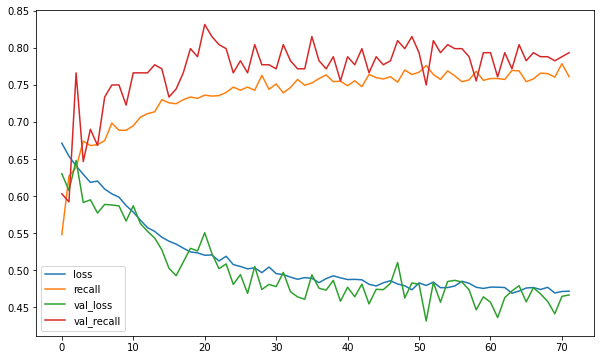

In [101]:
loss_df.plot();

#### Evaluate

In [102]:
model_weighted.evaluate(X_test, y_test, verbose=0)

[0.44216594099998474, 0.7696078419685364]

In [103]:
loss, recall = model_weighted.evaluate(X_test, y_test, verbose=0)
print("loss : ", loss)
print("recall : ", recall)

loss :  0.44216594099998474
recall :  0.7696078419685364


In [104]:
y_pred = (model_weighted.predict(X_test) > 0.5).astype("int32")
#y_pred = model.predict_classes(X_test)
print(confusion_matrix(y_test, y_pred))
print(classification_report(y_test, y_pred))

[[636 160]
 [ 47 157]]
              precision    recall  f1-score   support

           0       0.93      0.80      0.86       796
           1       0.50      0.77      0.60       204

    accuracy                           0.79      1000
   macro avg       0.71      0.78      0.73      1000
weighted avg       0.84      0.79      0.81      1000



### ROC (Receiver Operating Curve) and AUC (Area Under Curve) for keras_model_weighted

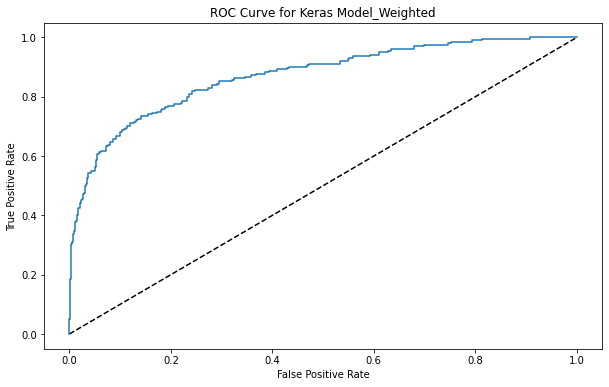

In [105]:
y_pred_proba = model_weighted.predict(X_test)
fpr, tpr, thresholds = roc_curve(y_test, y_pred_proba)
plt.plot([0,1],[0,1],'k--')
plt.plot(fpr,tpr, label='ANN')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curve for Keras Model_Weighted')
plt.show()

In [106]:
roc_auc_score(y_test, y_pred_proba)

0.8703813183564882

In [107]:
average_precision_score(y_test, y_pred_proba)

0.7271434206643099

## GridSearchCV

In [108]:
def build_classifier(optimizer):
    classifier = Sequential()
    classifier.add(Dense(units = 32, activation = 'relu'))
    classifier.add(Dropout(0.25))
    classifier.add(Dense(units = 16, activation = 'relu'))
    classifier.add(Dropout(0.25))
    classifier.add(Dense(units = 1, activation = 'sigmoid'))
    classifier.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ["Recall"])
    return classifier

In [109]:
early_stop = EarlyStopping(monitor = "loss", mode = "auto", verbose = 1, patience = 20)

In [110]:
class_weight = {0: class_weights[0], 1:class_weights[1]}

In [111]:
class_weight

{0: 0.6278777731268314, 1: 2.454991816693944}

In [112]:
classifier = KerasClassifier(build_fn = build_classifier, epochs = 200)
parameters = {'batch_size': [32, 64],
              'optimizer': ['adam', 'rmsprop', "SGD", "adagrad", "adadelta"]}
grid_model = GridSearchCV(estimator = classifier,
                          param_grid = parameters,
                          scoring = 'recall',
                          cv = 10,
                          n_jobs = -1,
                          verbose = 1)
grid_model.fit(X_train, y_train, callbacks = [early_stop], class_weight = class_weight)

Fitting 10 folds for each of 10 candidates, totalling 100 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.
2021-11-03 12:41:27.895611: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:937] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2021-11-03 12:41:27.916309: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:937] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2021-11-03 12:41:27.917484: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:937] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2021-11-03 12:41:27.918773: I tensorflow/core/platform/cpu_feature_guard.cc:142] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 AVX512F FMA
To ena

Epoch 1/200
282/282 [==============================] - 1s 3ms/step - loss: 0.6718 - recall: 0.5603
Epoch 2/200
282/282 [==============================] - 1s 3ms/step - loss: 0.6452 - recall: 0.6023
Epoch 3/200
282/282 [==============================] - 1s 3ms/step - loss: 0.6273 - recall: 0.6481
Epoch 4/200
282/282 [==============================] - 1s 5ms/step - loss: 0.6163 - recall: 0.6503
Epoch 5/200
282/282 [==============================] - 1s 3ms/step - loss: 0.5952 - recall: 0.6748
Epoch 6/200
282/282 [==============================] - 1s 3ms/step - loss: 0.5769 - recall: 0.6983
Epoch 7/200
282/282 [==============================] - 1s 3ms/step - loss: 0.5703 - recall: 0.6939
Epoch 8/200
282/282 [==============================] - 1s 3ms/step - loss: 0.5589 - recall: 0.6972
Epoch 9/200
282/282 [==============================] - 1s 3ms/step - loss: 0.5516 - recall: 0.7005
Epoch 10/200
282/282 [==============================] - 1s 3ms/step - loss: 0.5348 - recall: 0.7147
Epoch 11/

GridSearchCV(cv=10,
             estimator=<keras.wrappers.scikit_learn.KerasClassifier object at 0x7ffa202f6650>,
             n_jobs=-1,
             param_grid={'batch_size': [32, 64],
                         'optimizer': ['adam', 'rmsprop', 'SGD', 'adagrad',
                                       'adadelta']},
             scoring='recall', verbose=1)

In [113]:
grid_model.best_score_

nan

In [114]:
grid_model.best_params_

{'batch_size': 32, 'optimizer': 'adam'}

#### Evaluate

In [115]:
y_test_pred = (grid_model.predict(X_test) > 0.5).astype("int32")
print(confusion_matrix(y_test, y_test_pred))
print(classification_report(y_test, y_test_pred))

[[628 168]
 [ 49 155]]
              precision    recall  f1-score   support

           0       0.93      0.79      0.85       796
           1       0.48      0.76      0.59       204

    accuracy                           0.78      1000
   macro avg       0.70      0.77      0.72      1000
weighted avg       0.84      0.78      0.80      1000



### ROC (Receiver Operating Curve) and AUC (Area Under Curve) for grid_model

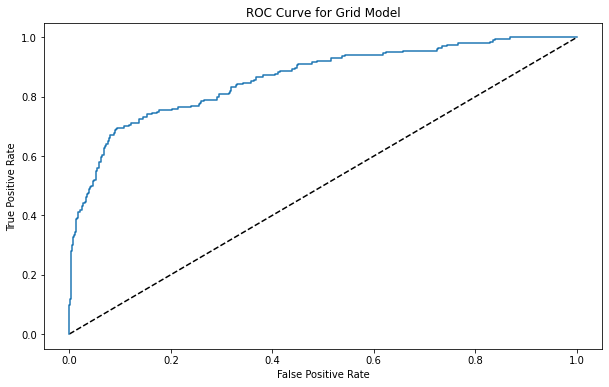

In [116]:
y_pred_proba = grid_model.predict_proba(X_test)[:,1]
fpr, tpr, thresholds = roc_curve(y_test, y_pred_proba)
plt.plot([0,1],[0,1],'k--')
plt.plot(fpr,tpr, label='ANN')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curve for Grid Model')
plt.show()

In [117]:
roc_auc_score(y_test, y_pred_proba)

0.862006108976254

In [118]:
average_precision_score(y_test, y_pred_proba)

0.7130176435818824

## Final Model and Model Deployment

In [119]:
import pickle
pickle.dump(scaler, open("scaler_exited", 'wb'))

In [120]:
final_model = Sequential()

final_model.add(Dense(32, activation = "relu"))
final_model.add(Dropout(0.25))
final_model.add(Dense(16, activation = "relu"))
final_model.add(Dropout(0.25))
final_model.add(Dense(1, activation = "sigmoid"))
                                           
opt = Adam(lr = 0.001)

final_model.compile(optimizer = opt, loss = "binary_crossentropy", metrics = ["Recall"])

early_stop = EarlyStopping(monitor = "val_loss", mode = "auto", verbose = 1, patience = 20)

class_weight = {0: 0.62787777, 1: 2.45499182}

final_model.fit(x=X_train,
                y=y_train,
                validation_data=(X_test, y_test),
                callbacks=[early_stop],
                batch_size=64,
                epochs=500,
                verbose=1,
                class_weight=class_weight)

Epoch 1/500
141/141 [==============================] - 1s 5ms/step - loss: 0.6879 - recall: 0.5657 - val_loss: 0.6395 - val_recall: 0.7010
Epoch 2/500
141/141 [==============================] - 1s 4ms/step - loss: 0.6521 - recall: 0.6023 - val_loss: 0.6254 - val_recall: 0.7255
Epoch 3/500
141/141 [==============================] - 0s 4ms/step - loss: 0.6385 - recall: 0.6410 - val_loss: 0.5960 - val_recall: 0.6961
Epoch 4/500
141/141 [==============================] - 1s 4ms/step - loss: 0.6225 - recall: 0.6459 - val_loss: 0.5850 - val_recall: 0.7108
Epoch 5/500
141/141 [==============================] - 1s 4ms/step - loss: 0.6119 - recall: 0.6721 - val_loss: 0.5636 - val_recall: 0.6716
Epoch 6/500
141/141 [==============================] - 1s 5ms/step - loss: 0.5992 - recall: 0.6836 - val_loss: 0.5966 - val_recall: 0.7647
Epoch 7/500
141/141 [==============================] - 0s 3ms/step - loss: 0.5920 - recall: 0.6836 - val_loss: 0.5589 - val_recall: 0.7108
Epoch 8/500
141/141 [======

/opt/conda/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:552: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/opt/conda/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 531, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/opt/conda/lib/python3.7/site-packages/keras/wrappers/scikit_learn.py", line 219, in fit
    return super(KerasClassifier, self).fit(x, y, **kwargs)
  File "/opt/conda/lib/python3.7/site-packages/keras/wrappers/scikit_learn.py", line 153, in fit
    self.model = self.build_fn(**self.filter_sk_params(self.build_fn))
  File "/tmp/ipykernel_26/2900810585.py", line 2, in build_classifier
  File "/opt/conda/lib/python3.7/site-packages/tensorflow/python/training/tracking/base.py", line 530, in _method_wrapper
    result = method(self, *args, **kwargs)
  File "/opt/conda/lib/pyt

141/141 [==============================] - 1s 4ms/step - loss: 0.4833 - recall: 0.7556 - val_loss: 0.4206 - val_recall: 0.7304
Epoch 45/500
141/141 [==============================] - 1s 4ms/step - loss: 0.4798 - recall: 0.7425 - val_loss: 0.4545 - val_recall: 0.7794
Epoch 46/500
141/141 [==============================] - 0s 3ms/step - loss: 0.4792 - recall: 0.7561 - val_loss: 0.4405 - val_recall: 0.7549
Epoch 47/500
129/141 [==========================>...] - ETA: 0s - loss: 0.4759 - recall: 0.7518Epoch 1/200
Epoch 1/200
Epoch 1/200
Epoch 1/200
Epoch 1/200
Epoch 1/200
141/141 [==============================] - 1s 4ms/step - loss: 0.4758 - recall: 0.7463 - val_loss: 0.4179 - val_recall: 0.7402
Epoch 48/500
 14/141 [=>............................] - ETA: 0s - loss: 0.4546 - recall: 0.7824

/opt/conda/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:552: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/opt/conda/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 531, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/opt/conda/lib/python3.7/site-packages/keras/wrappers/scikit_learn.py", line 219, in fit
    return super(KerasClassifier, self).fit(x, y, **kwargs)
  File "/opt/conda/lib/python3.7/site-packages/keras/wrappers/scikit_learn.py", line 162, in fit
    history = self.model.fit(x, y, **fit_args)
  File "/opt/conda/lib/python3.7/site-packages/keras/engine/training.py", line 1184, in fit
    tmp_logs = self.train_function(iterator)
  File "/opt/conda/lib/python3.7/site-packages/tensorflow/python/eager/def_function.py", line 885, in __call__
    result = self._call(*args, **kwds

141/141 [==============================] - 1s 6ms/step - loss: 0.4793 - recall: 0.7425 - val_loss: 0.4152 - val_recall: 0.7451
Epoch 49/500
141/141 [==============================] - 1s 5ms/step - loss: 0.4806 - recall: 0.7480 - val_loss: 0.4245 - val_recall: 0.7549
Epoch 50/500
141/141 [==============================] - 1s 6ms/step - loss: 0.4716 - recall: 0.7469 - val_loss: 0.4496 - val_recall: 0.7745
Epoch 51/500
141/141 [==============================] - 0s 3ms/step - loss: 0.4752 - recall: 0.7572 - val_loss: 0.4357 - val_recall: 0.7696
Epoch 52/500
141/141 [==============================] - 0s 3ms/step - loss: 0.4737 - recall: 0.7512 - val_loss: 0.4555 - val_recall: 0.7843
Epoch 53/500
141/141 [==============================] - 0s 3ms/step - loss: 0.4741 - recall: 0.7616 - val_loss: 0.4286 - val_recall: 0.7647
Epoch 54/500
141/141 [==============================] - 1s 4ms/step - loss: 0.4764 - recall: 0.7474 - val_loss: 0.4378 - val_recall: 0.7647
Epoch 55/500
141/141 [===========

<AxesSubplot:>

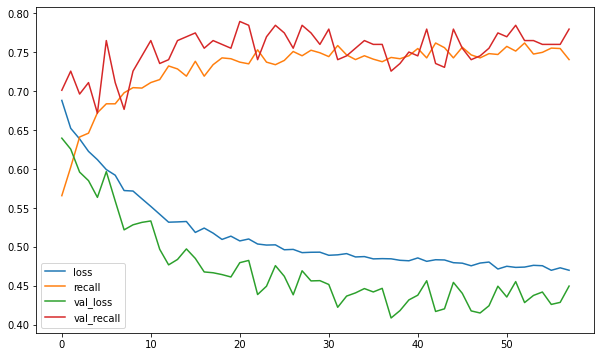

In [121]:
loss_df = pd.DataFrame(final_model.history.history)
loss_df.plot()

In [122]:
y_pred = (final_model.predict(X_test) > 0.5).astype("int32")
print(confusion_matrix(y_test, y_pred))
print(classification_report(y_test, y_pred))

[[646 150]
 [ 45 159]]
              precision    recall  f1-score   support

           0       0.93      0.81      0.87       796
           1       0.51      0.78      0.62       204

    accuracy                           0.81      1000
   macro avg       0.72      0.80      0.74      1000
weighted avg       0.85      0.81      0.82      1000



In [123]:
model.save('model_exited.h5')

### Loading Model and Scaler

In [124]:
from tensorflow.keras.models import load_model

In [125]:
model_exited = load_model('model_exited.h5')
scaler_exited = pickle.load(open("scaler_exited", "rb"))

### Prediction

In [126]:
first_ten_customer = df.drop('Exited', axis = 1).iloc[0:10, :]
first_ten_customer

,CreditScore,Age,Tenure,Balance,NumOfProducts,HasCrCard,IsActiveMember,EstimatedSalary,Geography_France,Geography_Germany,Geography_Spain,Gender_Female,Gender_Male
0,619,42,2,0.000,1,1,1,101348.880,1,0,0,1,0
1,608,41,1,83807.860,1,0,1,112542.580,0,0,1,1,0
2,502,42,8,159660.800,3,1,0,113931.570,1,0,0,1,0
3,699,39,1,0.000,2,0,0,93826.630,1,0,0,1,0
4,850,43,2,125510.820,1,1,1,79084.100,0,0,1,1,0
5,645,44,8,113755.780,2,1,0,149756.710,0,0,1,0,1
6,822,50,7,0.000,2,1,1,10062.800,1,0,0,0,1
7,376,29,4,115046.740,4,1,0,119346.880,0,1,0,1,0
8,501,44,4,142051.070,2,0,1,74940.500,1,0,0,0,1
9,684,27,2,134603.880,1,1,1,71725.730,1,0,0,0,1


In [127]:
first_ten_customer = scaler_exited.transform(first_ten_customer)
first_ten_customer

array([[0.538     , 0.32432432, 0.2       , 0.        , 0.        ,
        1.        , 1.        , 0.50673489, 1.        , 0.        ,
        0.        , 1.        , 0.        ],
       [0.516     , 0.31081081, 0.1       , 0.33403148, 0.        ,
        0.        , 1.        , 0.56270874, 0.        , 0.        ,
        1.        , 1.        , 0.        ],
       [0.304     , 0.32432432, 0.8       , 0.63635718, 0.66666667,
        1.        , 0.        , 0.56965435, 1.        , 0.        ,
        0.        , 1.        , 0.        ],
       [0.698     , 0.28378378, 0.1       , 0.        , 0.33333333,
        0.        , 0.        , 0.46912005, 1.        , 0.        ,
        0.        , 1.        , 0.        ],
       [1.        , 0.33783784, 0.2       , 0.50024622, 0.        ,
        1.        , 1.        , 0.39540036, 0.        , 0.        ,
        1.        , 1.        , 0.        ],
       [0.59      , 0.35135135, 0.8       , 0.45339436, 0.33333333,
        1.        , 0.     

In [128]:
(model_exited.predict(first_ten_customer) > 0.5).astype("int32")

array([[0],
       [0],
       [1],
       [0],
       [0],
       [0],
       [0],
       [1],
       [0],
       [0]], dtype=int32)

In [129]:
# rm -rf .nv/

In [130]:
df["Exited"].iloc[0:10]

0    1
1    0
2    1
3    0
4    0
5    1
6    0
7    1
8    0
9    0
Name: Exited, dtype: int64

## Conclusion

In the above study, we;
- Implemented basic steps to see how data looks like,
- Checked for missing values,
- Dropped the features that not suitable for modelling,
- Implemented basic visualization steps such as histogram, countplot, heatmap,
- Converted categorical variables to dummy variables,
- Created models with Keras,
- Chose final model and deployed it,
- And finally made prediction with final model.